# Basic Image Processing

Images can be represented as matrix form in computers. The values of this matrix may correspond to pixel intensities. A pixel of an image is same as a component of a matrix.

2D images have weight and height dimensions as well as matrices.

Also images have color spaces. An image can be either gray scaled or colored. A gray scaled image has one channel with weight and height dimensions, also a colored image has 3 channels with weight and height dimensions. In colored image's channels generally correspond to **(R)ed**, **(G)ray** and **(B)lue**. Thus, colored images oftenly denoted as RGB images. Let's start with gray scale images:

In [ ]:
#!pip3 install opencv-python

In [35]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

In [37]:
img1 = cv2.imread('./images/lena.png',0)
print(img1.shape)
print(type(img1))
print(img1)

(567, 567)
<class 'numpy.ndarray'>
[[159 159 157 ... 167 151 118]
 [159 159 157 ... 167 151 118]
 [159 159 157 ... 167 151 118]
 ...
 [ 20  28  24 ...  90  86  84]
 [ 22  34  30 ...  90  92  96]
 [ 22  34  30 ...  90  92  96]]


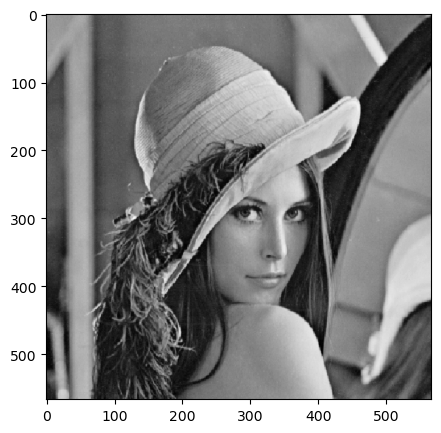

In [39]:
fig = plt.figure(figsize=(5,5))
plt.imshow(img1,cmap='gray')
plt.show()

RGB images:

In [42]:
img2 = cv2.imread('./images/rgb1.jpg')
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)
print(img2.shape)
print(type(img2))
print('First channel: ',img2[:,:,0])
print('Second channel: ',img2[:,:,1])
print('Third channel: ',img2[:,:,2])

(1300, 1000, 3)
<class 'numpy.ndarray'>
First channel:  [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Second channel:  [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Third channel:  [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


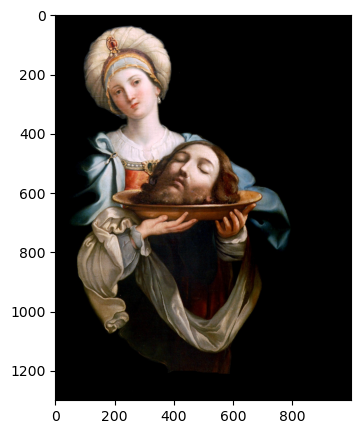

In [44]:
fig = plt.figure(figsize=(5,5))
plt.imshow(img2)
plt.show()

## Kernels

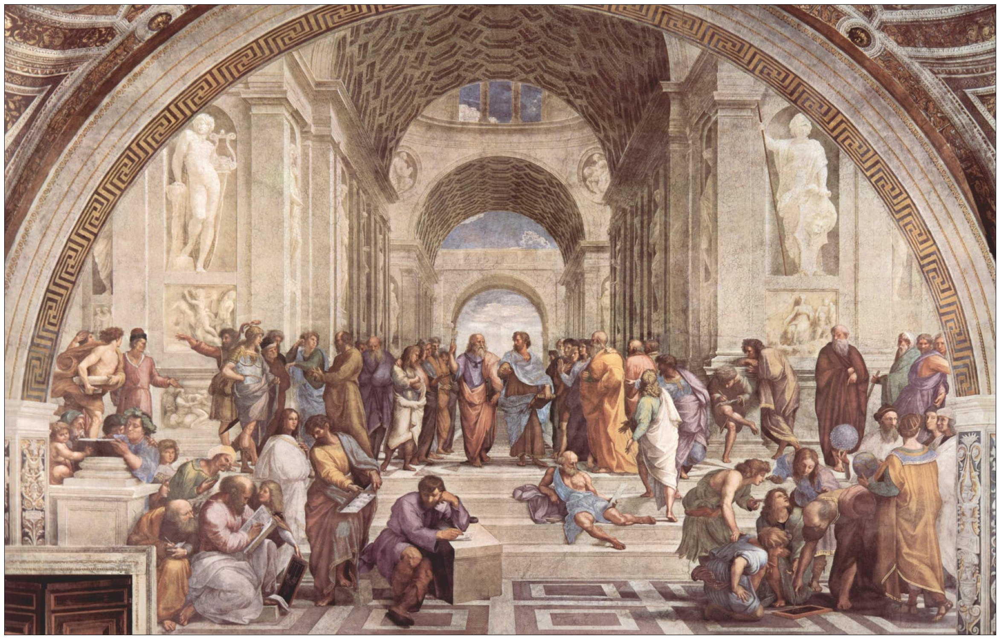

In [47]:
img3 = cv2.imread('./images/kernel.jpeg')
img3 = cv2.cvtColor(img3,cv2.COLOR_BGR2RGB)
fig = plt.figure(figsize=(30,30))
plt.imshow(img3)
plt.xticks([])
plt.yticks([])
plt.show()

Cool, now let’s make a kernel for blurring the image.

In [50]:
kernel1 =np.array([[0, -1, 0],
                 [-1, 5, -1],
                 [0, -1, 0]])
kernel1

array([[ 0, -1,  0],
       [-1,  5, -1],
       [ 0, -1,  0]])

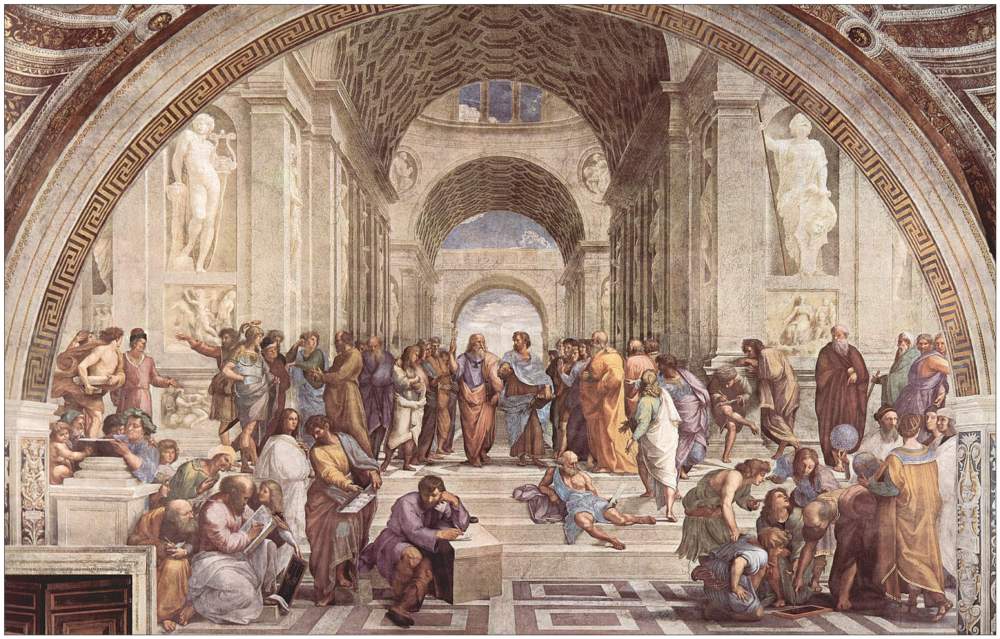

In [52]:
img3_1 = cv2.filter2D(img3, -1, kernel1)
fig = plt.figure(figsize=(30,30))
plt.imshow(img3_1)
plt.xticks([])
plt.yticks([])
plt.show()

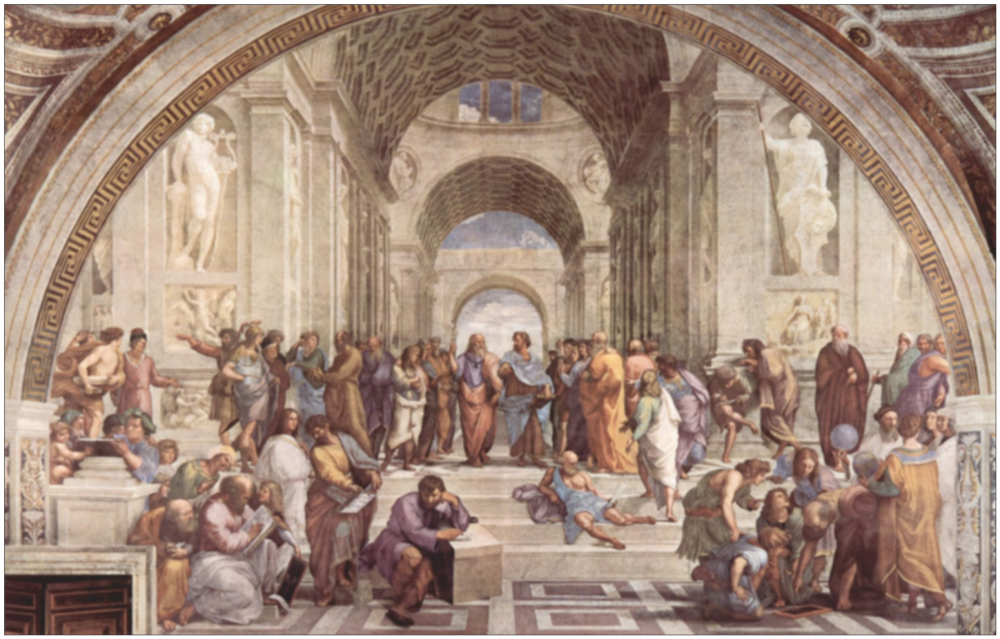

In [53]:
img3_2 = cv2.blur(img3, (5,5))
fig = plt.figure(figsize=(30,30))
plt.imshow(img3_2)
plt.xticks([])
plt.yticks([])
plt.show()

In [54]:
kernel3 = np.array([[-1, -1, -1],
                    [-1, 8, -1],
                    [-1, -1, -1]])
kernel3

array([[-1, -1, -1],
       [-1,  8, -1],
       [-1, -1, -1]])

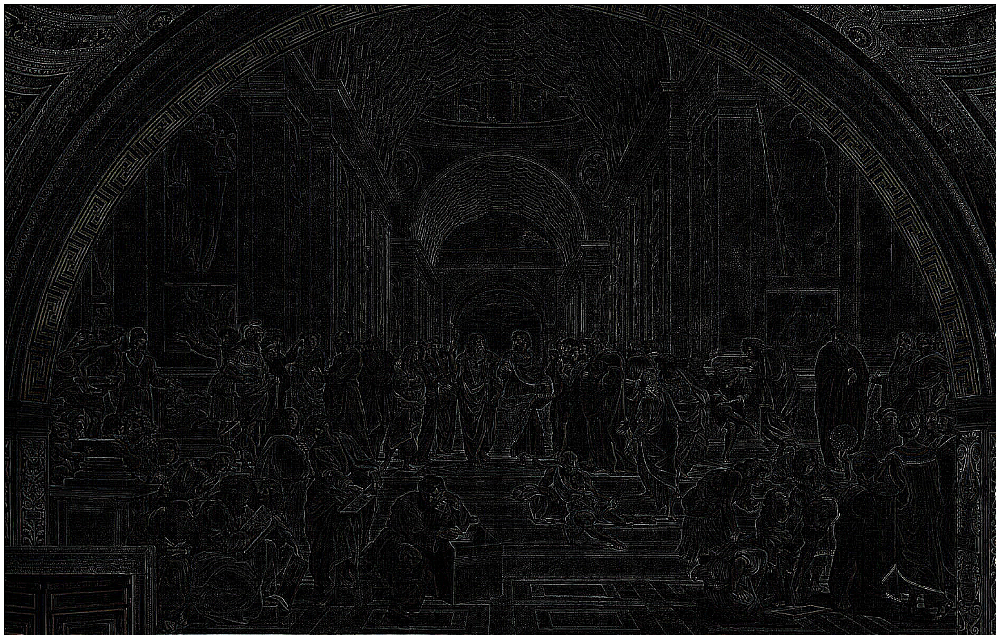

In [58]:
img3_3 = cv2.filter2D(img3, -1, kernel3)
fig = plt.figure(figsize=(30,30))
plt.imshow(img3_3)
plt.xticks([])
plt.yticks([])
plt.show()

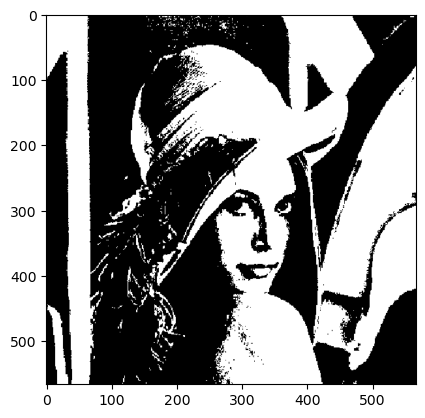

In [59]:
_, th = cv2.threshold(img1, 127, 255, cv2.THRESH_BINARY)
plt.imshow(th,cmap='gray')

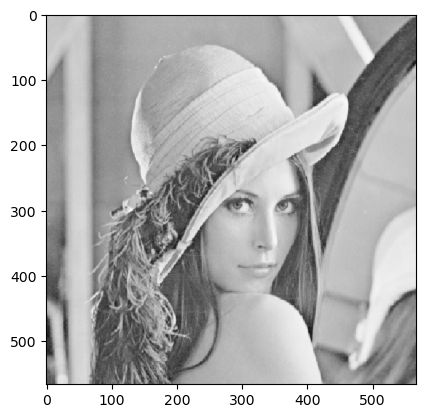

In [62]:
img1 = cv2.imread('./images/lena.png',0)
img1 = img1 ** (1/2)
plt.imshow(img1,cmap='gray')

# Practical example of a DNN

In [1]:
#pip install --upgrade keras

In [ ]:
# We import torch & TF so as to use torch Dataloaders & tf.data.Datasets.
#import torch
import tensorflow as tf

import os
import numpy as np
import keras
from keras import layers
from keras import ops
import matplotlib.pyplot as plt
import plotly.express as px

In [ ]:
(X_train, Y_train), (X_test, Y_test) = keras.datasets.mnist.load_data()

11490434/11490434 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [ ]:
num = 10
images = X_train[:num]
labels = Y_train[:num]

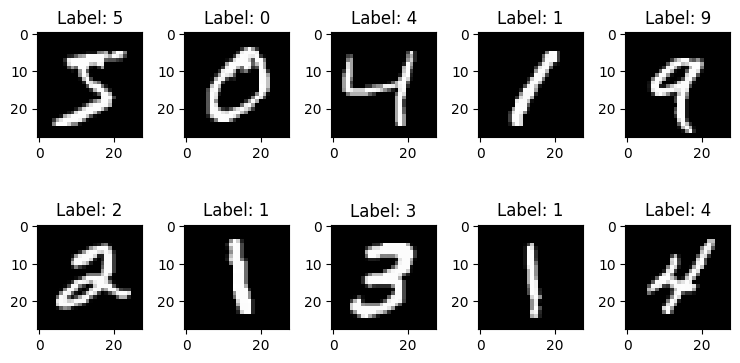

In [ ]:
num_row = 2
num_col = 5

# plot images
fig, axes = plt.subplots(num_row, num_col, figsize=(1.5*num_col,2*num_row))
for i in range(num):
    ax = axes[i//num_col, i%num_col]
    ax.imshow(images[i], cmap='gray')
    ax.set_title('Label: {}'.format(labels[i]))
plt.tight_layout()
plt.show()

In [ ]:
# Function return digit in grayscale
def plot_digit(digit, dem = 28, font_size = 12):
    max_ax = font_size * dem

    fig = plt.figure(figsize=(13, 13))
    plt.xlim([0, max_ax])
    plt.ylim([0, max_ax])
    plt.axis('off')
    black = '#000000'

    for idx in range(dem):
        for jdx in range(dem):

            t = plt.text(idx * font_size, max_ax - jdx*font_size, digit[jdx][idx], fontsize = font_size, color = black)
            c = digit[jdx][idx] / 255.
            t.set_bbox(dict(facecolor=(c, c, c), alpha = 0.5, edgecolor = 'black'))

    plt.show()

5


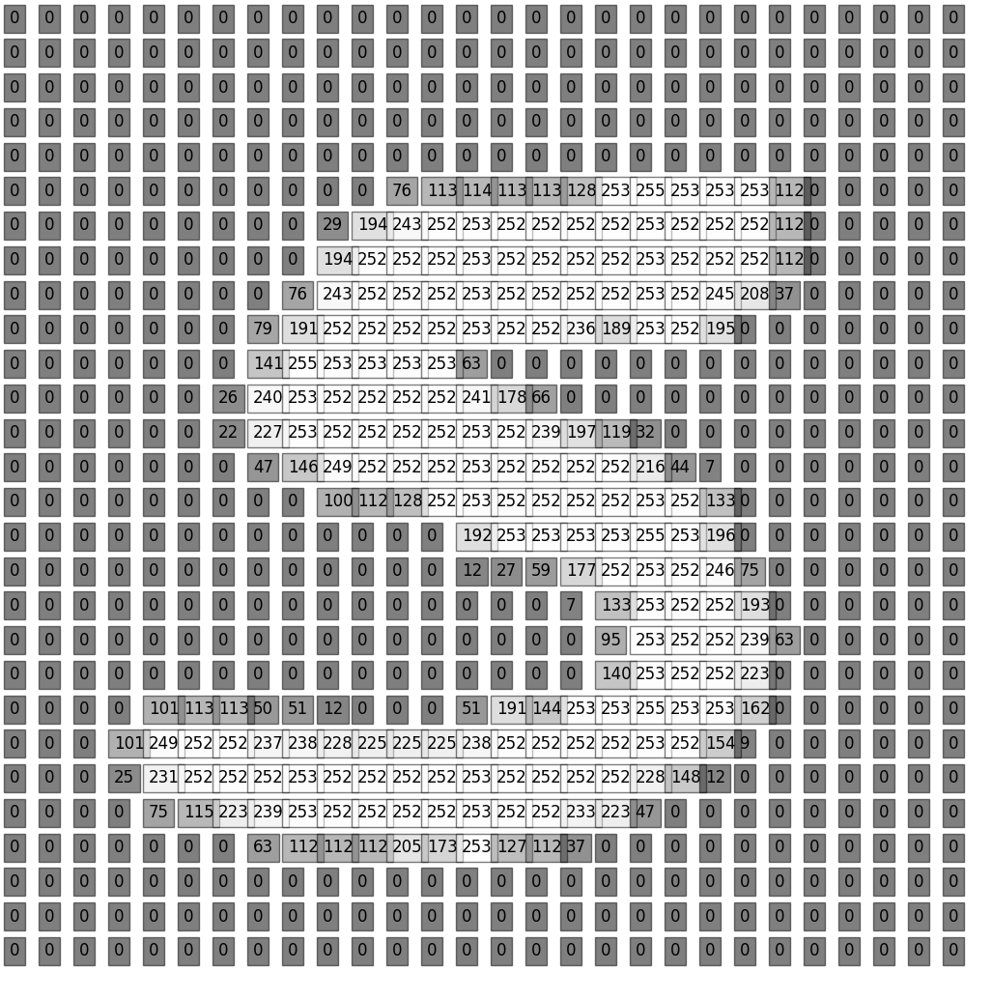

In [ ]:
rand_number = np.random.randint(0, len(Y_train))
print(Y_train[rand_number])
plot_digit(X_train.reshape(-1, 28, 28)[rand_number])

In [ ]:
inputs = keras.Input(shape=(784,), name="digits") #28*28
x = layers.Dense(64, activation="relu", name="dense_1")(inputs)
x = layers.Dense(64, activation="relu", name="dense_2")(x)
outputs = layers.Dense(10, activation="softmax", name="predictions")(x)

model = keras.Model(inputs=inputs, outputs=outputs)

Here's what the typical end-to-end workflow looks like, consisting of:

- Training
- Validation on a holdout set generated from the original training data
- Evaluation on the test data

In [ ]:
(x_train, y_train), (x_test, y_test) = keras.datasets.mnist.load_data()

# Preprocess the data (these are NumPy arrays)
x_train = x_train.reshape(60000, 784).astype("float32") / 255
x_test = x_test.reshape(10000, 784).astype("float32") / 255

y_train = y_train.astype("float32")
y_test = y_test.astype("float32")

# Reserve 10,000 samples for validation
x_val = x_train[-10000:]
y_val = y_train[-10000:]
x_train = x_train[:-10000]
y_train = y_train[:-10000]

11490434/11490434 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


We specify the training configuration (optimizer, loss, metrics):

In [ ]:
model.compile(
    optimizer=keras.optimizers.RMSprop(),  # Optimizer
    # Loss function to minimize
    loss=keras.losses.SparseCategoricalCrossentropy(),
    # List of metrics to monitor
    metrics=[keras.metrics.SparseCategoricalAccuracy()],
)

We call `fit()`, which will train the model by slicing the data into "batches" of size
`batch_size`, and repeatedly iterating over the entire dataset for a given number of
`epochs`.

In [ ]:
print("Fit model on training data")
history = model.fit(
    x_train,
    y_train,
    batch_size=64,
    epochs=10,
    # We pass some validation for
    # monitoring validation loss and metrics
    # at the end of each epoch
    validation_data=(x_val, y_val),
)

Fit model on training data
Epoch 1/10
782/782 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.5777 - sparse_categorical_accuracy: 0.8398 - val_loss: 0.1757 - val_sparse_categorical_accuracy: 0.9503
Epoch 2/10
782/782 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step - loss: 0.1669 - sparse_categorical_accuracy: 0.9511 - val_loss: 0.1502 - val_sparse_categorical_accuracy: 0.9538
Epoch 3/10
782/782 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1161 - sparse_categorical_accuracy: 0.9644 - val_loss: 0.1090 - val_sparse_categorical_accuracy: 0.9672
Epoch 4/10
782/782 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.0878 - sparse_categorical_accuracy: 0.9733 - val_loss: 0.1050 - val_sparse_categorical_accuracy: 0.9682
Epoch 5/10
782/782 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0715 - sparse_categorical_accuracy: 0.9775 - val_loss: 0.1132 - val_sparse_categorical_accuracy: 0.9680
Epoch 6/10
782/782 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0621 - sparse_categorical_accuracy: 0.9805 - val_loss: 0.0992 - val_sparse_catego

The returned `history` object holds a record of the loss values and metric values
during training:

In [ ]:
print(history.history)

{'loss': [0.34293168783187866, 0.1573789417743683, 0.11358510702848434, 0.09031527489423752, 0.0744362473487854, 0.06367935240268707, 0.054975252598524094, 0.04800933972001076, 0.042894139885902405, 0.03745567798614502], 'sparse_categorical_accuracy': [0.9031000137329102, 0.9532999992370605, 0.9657800197601318, 0.9726799726486206, 0.9769600033760071, 0.9808800220489502, 0.9839000105857849, 0.9859399795532227, 0.987280011177063, 0.9886000156402588], 'val_loss': [0.17571361362934113, 0.15016363561153412, 0.10902963578701019, 0.10499084740877151, 0.11318952590227127, 0.09919892251491547, 0.09975317120552063, 0.10446236282587051, 0.09988054633140564, 0.10009895265102386], 'val_sparse_categorical_accuracy': [0.9502999782562256, 0.9538000226020813, 0.967199981212616, 0.9682000279426575, 0.9679999947547913, 0.9724000096321106, 0.9731000065803528, 0.9735999703407288, 0.975600004196167, 0.974399983882904]}


We evaluate the model on the test data via `evaluate()`:

In [ ]:
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
results = model.evaluate(x_test, y_test, batch_size=128)
print("test loss, test acc:", results)

# Generate predictions (probabilities -- the output of the last layer)
# on new data using `predict`
print("Generate predictions for 3 samples")
predictions = model.predict(x_test[:3])
print("predictions shape:", predictions.shape)

Evaluate on test data
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0994 - sparse_categorical_accuracy: 0.9729
test loss, test acc: [0.0875270888209343, 0.9765999913215637]
Generate predictions for 3 samples
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
predictions shape: (3, 10)
